In [1]:
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

import numpy as npy
import pylab as py

from scipy.io import netcdf
import scipy.signal as si

from matplotlib.colors import LogNorm
%matplotlib inline

In [2]:
fdir = "/home/albert/Data/GPCP/"

pfile1 = fdir + 'GPCP_1DD_v1.2_1998-2010.nc'
pfile2 = fdir + 'GPCP_v12_precip_1998_2010.nc'
mfile = fdir + 'precip_TRMM_halfdegree_akima_y1998.nc'

In [3]:
fprecip1 = netcdf.netcdf_file(pfile1,'r')
fprecip2 = netcdf.netcdf_file(pfile2,'r')
fmask = netcdf.netcdf_file(mfile,'r')


In [4]:
precip1 = fprecip1.variables['PREC']
precip2 = fprecip2.variables['Precip']

lat1 = fprecip1.variables['lat']
lon1 = fprecip1.variables['lon']
time = fprecip1.variables['time']

lat2 = fprecip2.variables['lat']
lon2 = fprecip2.variables['lon']

mask = fmask.variables['precip']

In [5]:
lat1a=lat1[:]
lon1a=lon1[:]
lat2a=lat2[:]
lon2a=lon2[:]
precip1a=precip1[:]
precip2a=precip2[:]
timea=time[:]
print(npy.min(precip2a))

0.0


In [6]:
def number_wet_days(lat,lon,time,precip):
    wet=npy.zeros((len(lat),len(lon)))
    intens=npy.zeros((len(lat),len(lon)))

    data_wet=npy.zeros((len(time),len(lat),len(lon)))
    data_wet[:]=precip[:]

    for i in npy.arange(0,len(lat),1):
        if npy.abs(lat[i])<50:
            for j in npy.arange(0,len(lon),1):
                r = 0
                for k in npy.arange(0,len(time),1):
                    if precip[k,i,j] <= 0.0:
                        data_wet[k,i,j] = 0.0
                    else:
                        r = r+1
                if r<>0.:
                    wet[i,j] = r/float(len(time)) * 100.
                    intens[i,j] = sum(data_wet[:,i,j])/r
    return wet,intens

In [7]:
wet1,intens1=number_wet_days(lat1a,lon1a,timea,precip1a)
wet2,intens2=number_wet_days(lat2a,lon2a,timea,precip2a)

In [23]:
mask1=npy.equal(precip1a,-99999)
precip1m=npy.ma.array(precip1a,mask=mask1)
T=npy.arange(0,len(timea),1)
T.dtype
len(timea)

4748

/home/albert/anaconda2/lib/python2.7/site-packages/matplotlib/pyplot.py:516: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


KeyboardInterrupt: 

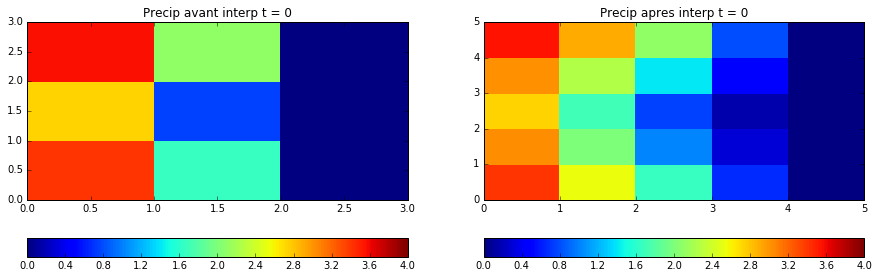

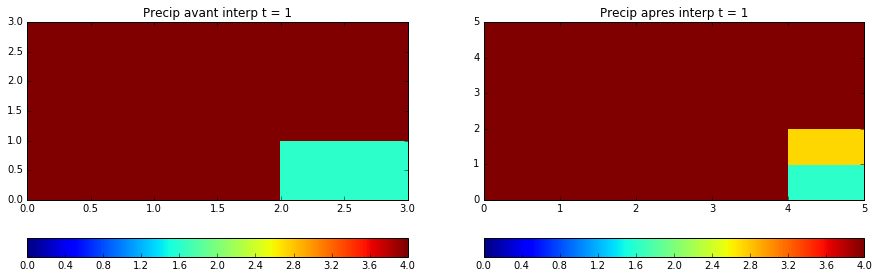

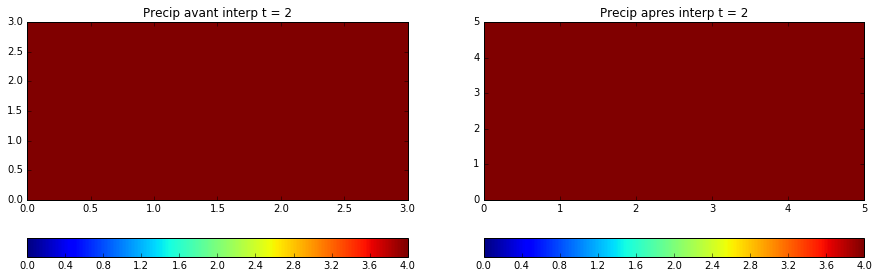

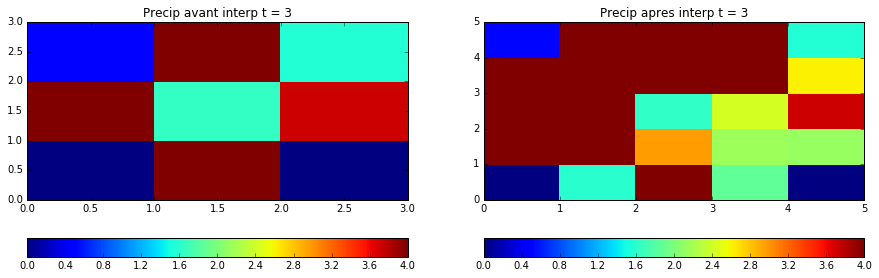

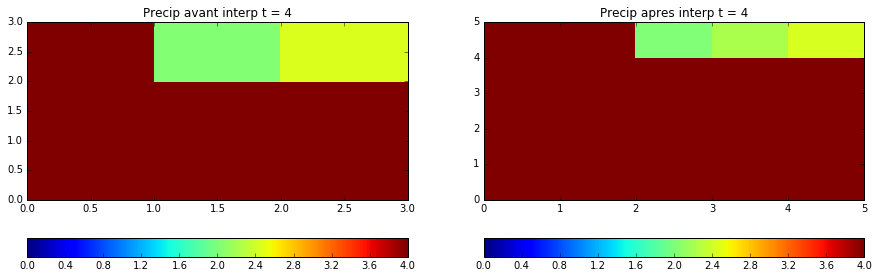

...

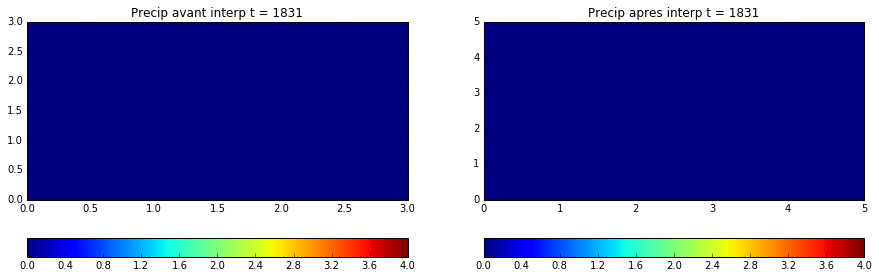

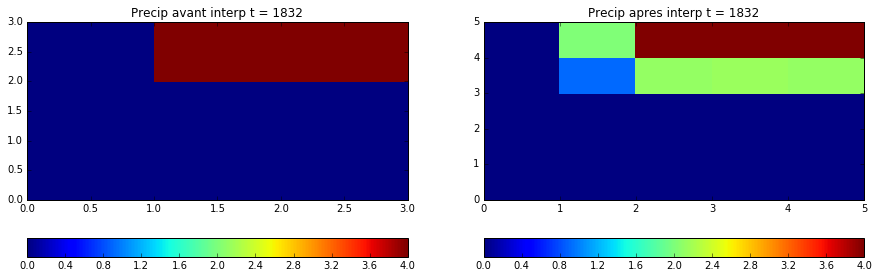

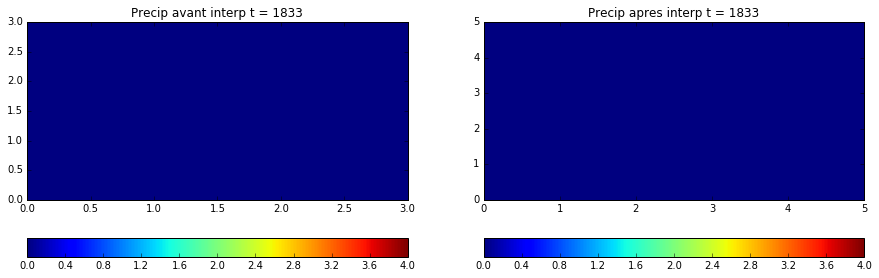

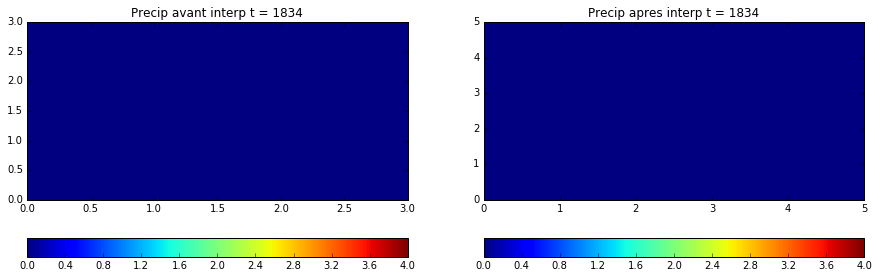

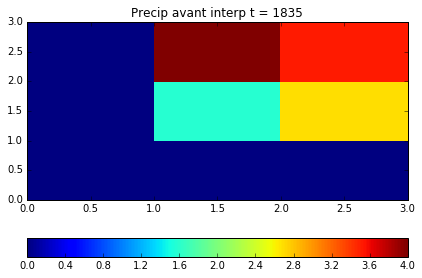

In [22]:
for t in npy.arange(0,len(timea),1):
    t.dtype
    plt.figure(figsize=(15,10))

    plt.subplot(2,2,3)
    plt.pcolor(precip1m[t,39:42,9:12],vmin=0,vmax=4)
    plt.colorbar(orientation='horizontal')
    plt.title('Precip avant interp t = '+npy.str(t))

    plt.subplot(2,2,4)
    plt.pcolor(precip2a[t,79:84,19:24],vmin=0,vmax=4)
    plt.colorbar(orientation='horizontal')
    plt.title('Precip apres interp t = '+npy.str(t))
    
    plt.savefig('/home/albert/Data/GPCP/PLOTS/precip_avant_apres_interp_t'+npy.str(t)+'.png')


50.5
9.5
50.5
9.5
[0.0038309955596922407 0.004951934814453551 -0.00047309875488288355 0.0
 -0.0038938522338867188 -0.004025802612305007 -0.0015027809143068893 0.0
 0.004945068359375027 0.0 0.0 0.0 -0.0024762916564942117 0.0
 0.0015949344635011187 -0.0032080650329593396 0.0 -0.0035472106933589487
 -0.002674255371093892 0.004168887138366717 0.0 0.0 0.0
 -0.0035010147094727273 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0
 -0.0013899636268616122 -8.648395538335407e-05 0.0018056106567381214 0.0
 -0.0038603687286377086 -0.004738187789917081 0.0045800304412839665 0.0
 -0.0020598340034484464 -0.003767766952514684 -0.004656365364789963 0.0 0.0
 0.0 0.0032751077413558927 -0.004243450164794993 0.0 0.0031598281860349964
 -0.003857059478759778 0.0 0.0027733260393142667 -0.0008090686798096769 0.0
 -0.004814367294311506 -0.0024936103820802913 0.004806976318359801
 -0.004242553710937624 -0.003766479492188779 -0.004625444412231339 0.0 0.0
 0.0 -0.0017996501922605823 0.0 0.0 0.0 0.003408541679382

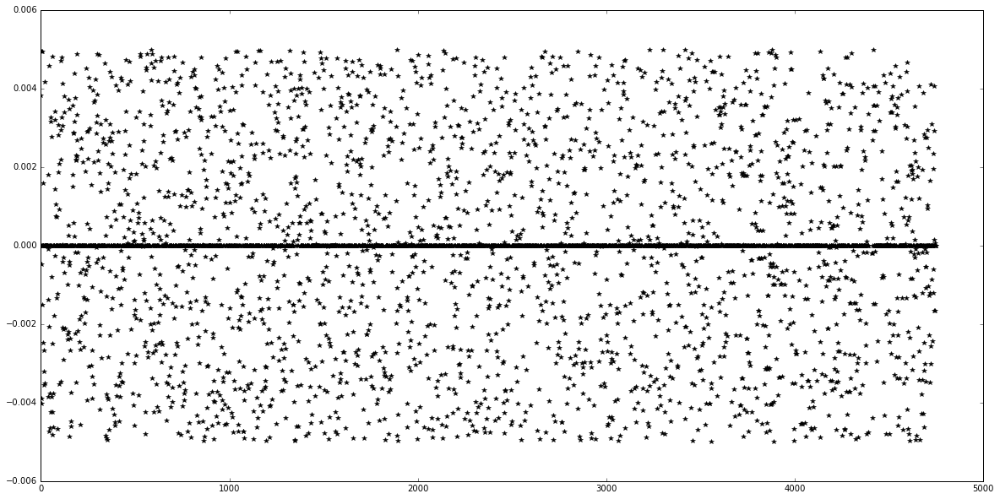

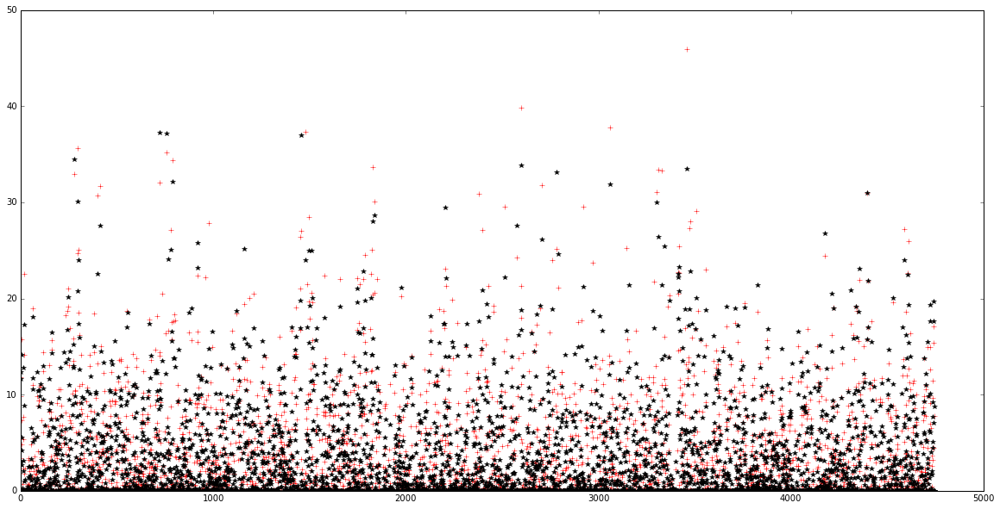

In [87]:
print(lat2[79])
print(lon2[19])
print(lat1[39])
print(lon1[9])

plt.figure(figsize=(20,10))
#plt.plot(precip1m[:,39,9],'b*')
#plt.plot(precip2a[:,79,19],'r+')
plt.plot(precip1m[:,39,9]-precip2a[:,79,19],'k*')
diff=precip1m[:,39,9]-precip2a[:,79,19]
print(diff[0:100])

plt.figure(figsize=(20,10))
plt.plot(precip2a[:,79,19],'r+')
plt.plot(precip2a[:,80,19],'k*')


[0, 300, 0, 60]

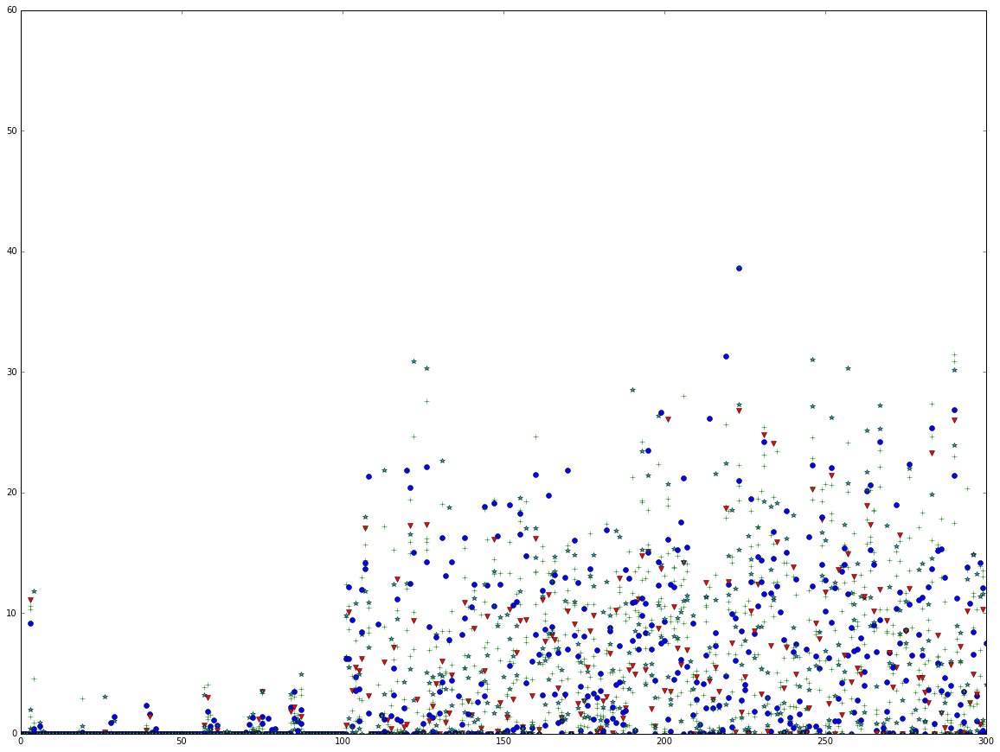

In [39]:
plt.figure(figsize=(20,15))
plt.plot(precip1a[:,81,21],'c*')
plt.plot(precip1a[:,82,21],'g+')
plt.plot(precip1a[:,83,21],'bo')
plt.plot(precip1a[:,81,22],'g+')
plt.plot(precip1a[:,82,22],'rv')
plt.plot(precip1a[:,83,22],'g+')
plt.plot(precip1a[:,81,23],'bo')
plt.plot(precip1a[:,82,23],'g+')
plt.plot(precip1a[:,83,23],'c*')
plt.axis([0, 300, 0, 60])

In [46]:
precip1s=0.*precip1a
precip2s=0.*precip2a
precip1s[npy.where(precip1a>0.)]=1
precip2s[npy.where(precip2a>0.)]=1


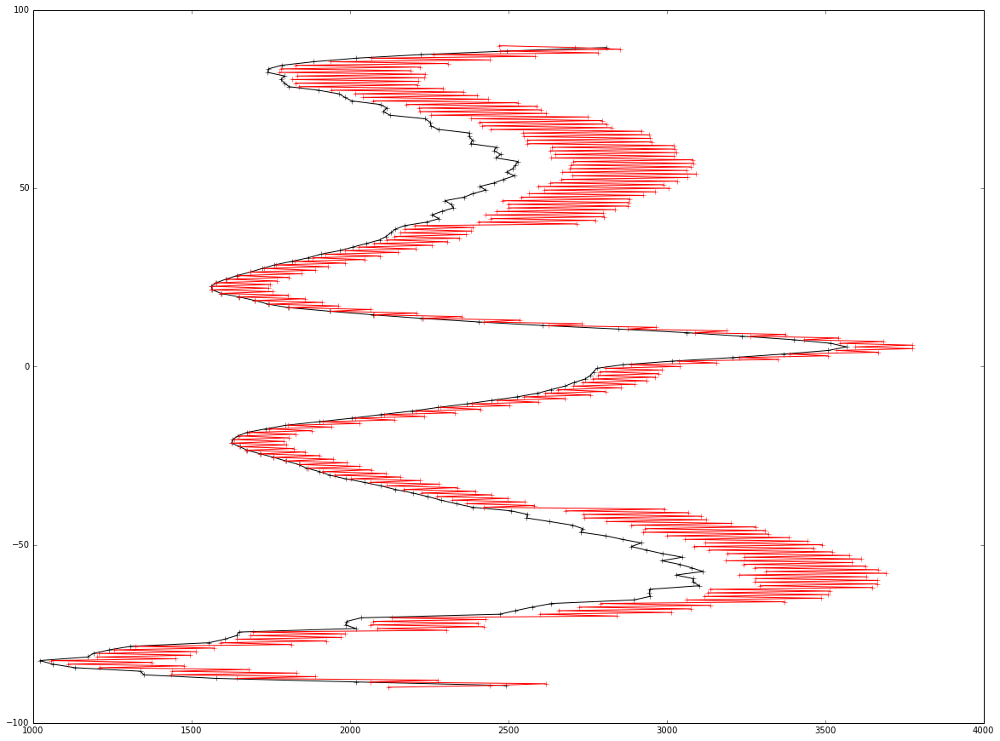

In [53]:
pzonal1=npy.mean(npy.sum(precip1s,0),1)
pzonal2=npy.mean(npy.sum(precip2s,0),1)

plt.figure(figsize=(20,15))
plt.plot(pzonal1,lat1a,'k-+')
plt.plot(pzonal2,lat2a,'r-+')
#plt.axis([30, 80, 40, 50])


In [52]:
truc=npy.sum(precip1s,0)
precip1s.shape

(4748, 180, 360)

[100, 110, -1, 2]

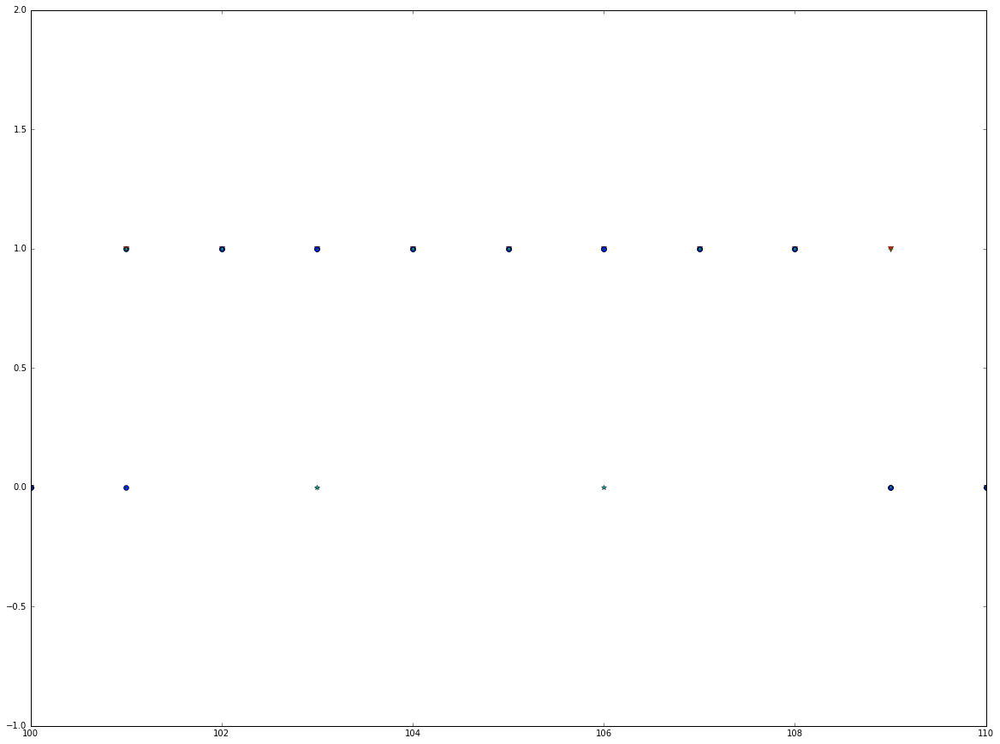

In [49]:
plt.figure(figsize=(20,15))
plt.plot(precip1s[:,81,21],'c*')
plt.plot(precip1s[:,82,21],'g+')
plt.plot(precip1s[:,83,21],'bo')
plt.plot(precip1s[:,81,22],'g+')
plt.plot(precip1s[:,82,22],'rv')
plt.plot(precip1s[:,83,22],'g+')
plt.plot(precip1s[:,81,23],'bo')
plt.plot(precip1s[:,82,23],'g+')
plt.plot(precip1s[:,83,23],'c*')
plt.axis([100, 110, -1, 2])